## Задача 1
Постройте график  
Назовите график  
Сделайте именование оси x и оси y  
Сделайте выводы  

### 1.1. Скачать следующие данные: kc-house-data и laptop_price

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import folium

df = pd.read_csv("kc-house-data.csv")
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


### 1.2. Изучите стоимости недвижимости

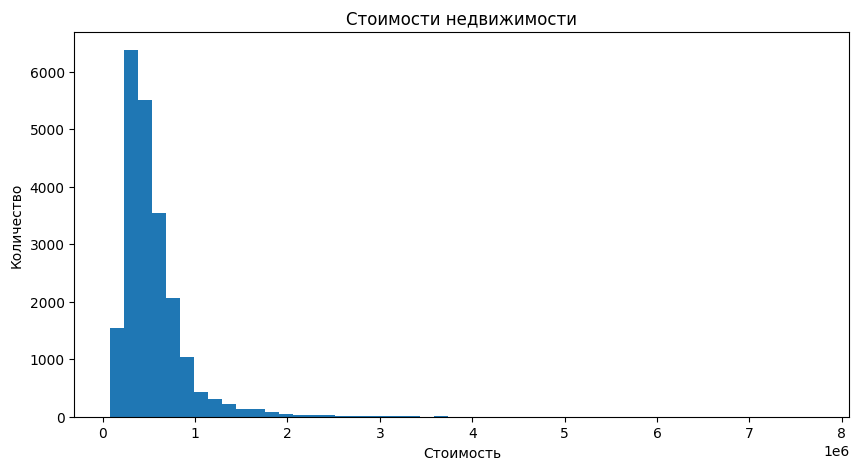

In [30]:
plt.figure(figsize=(10, 5))
plt.hist(df['price'], bins=50)
plt.title('Стоимости недвижимости')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

1.2. - график показывает, что наиболее популярная ценовая категория составляет примерно 500.000.  

### 1.3. Изучите распределение квадратуры жилой

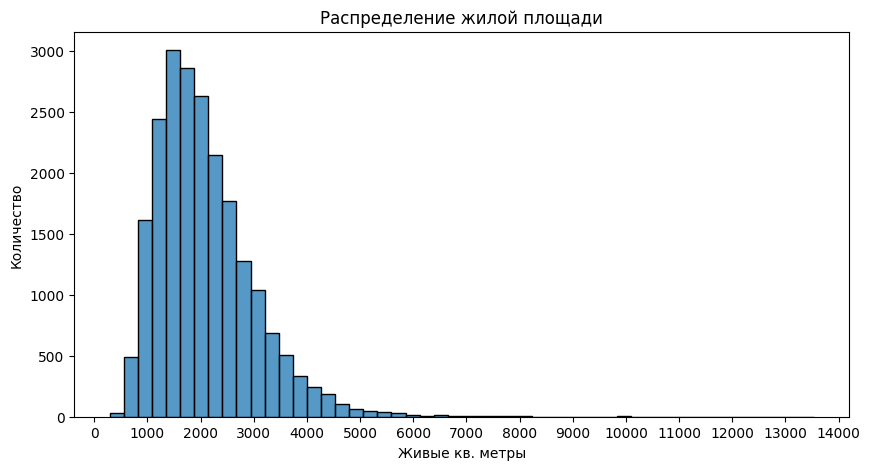

In [59]:
plt.figure(figsize=(10, 5))
sns.histplot(df['sqft_living'], bins=50)
plt.title('Распределение жилой площади')
plt.xlabel('Живые кв. метры')
plt.ylabel('Количество')
plt.xticks(range(0,15000,1000));

1.3. - график показывает, что наиболее популярные квартиры с жилой квадратуры от 1.000 до 2.500 квадрытных футов.  

### 1.4. Изучите распределение года постройки

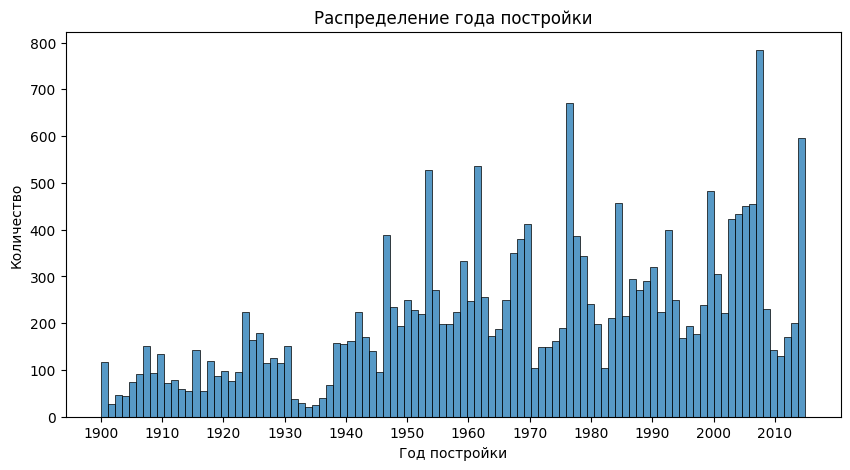

In [5]:
plt.figure(figsize=(10, 5))
sns.histplot(df['yr_built'], bins=100)
plt.title('Распределение года постройки')
plt.xlabel('Год постройки')
plt.ylabel('Количество')
plt.xticks(range(1900,2020,10));

1.4. - график показывает, что постройки широко распределены по годам постройки.  

## Задача 2
### 2.1. Изучите распределение домов от наличия вида на набережную
Постройте график  
Сделайте выводы  

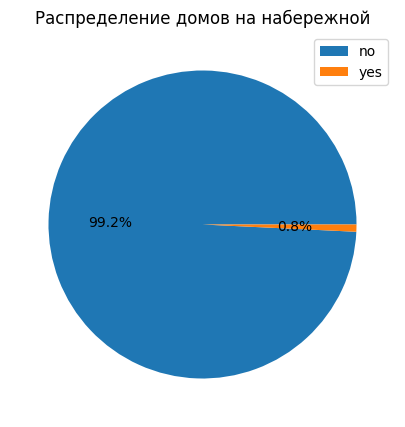

In [14]:
data = df['waterfront'].value_counts()

plt.figure(figsize=(10, 5))
plt.pie(data, autopct='%1.1f%%')
plt.title('Распределение домов на набережной')
plt.legend(['no', 'yes']);

2.1. - график показывает, что количество построек на берегу меньше одного процента.  

### 2.2. Изучите распределение этажей домов

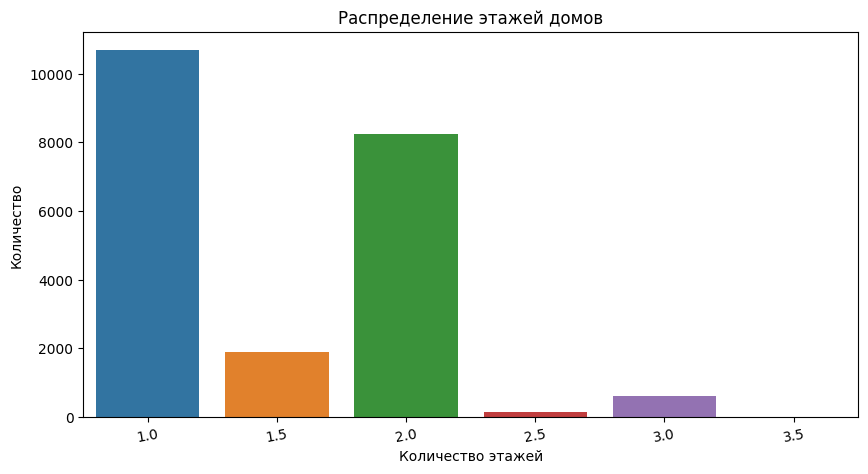

In [24]:
data = df['floors'].value_counts()

plt.figure(figsize=(10, 5))
sns.barplot(x = data.index, y = data)
plt.title('Распределение этажей домов')
plt.xlabel('Количество этажей')
plt.ylabel('Количество')
plt.xticks(rotation=10);

2.2. - график показывает, что наибольшее количество одноэтажных и двухэтажных домов.  

### 2.3. Изучите распределение состояния домов

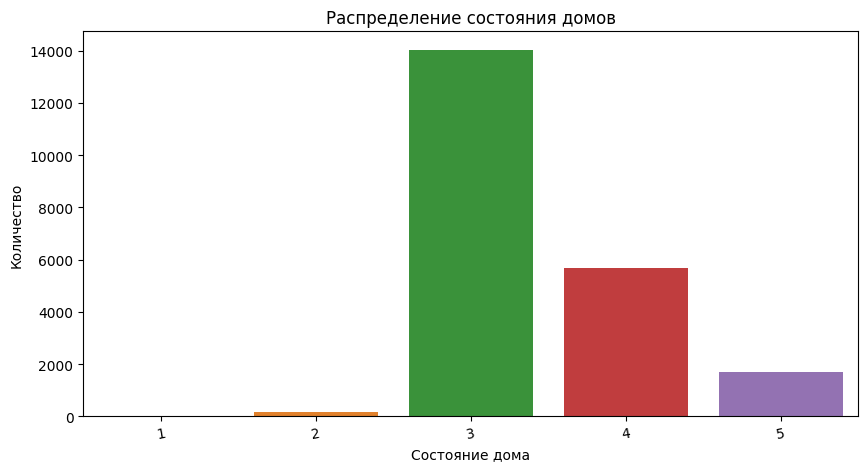

In [32]:
data = df['condition'].value_counts()

plt.figure(figsize=(10, 5))
sns.barplot(x = data.index, y = data)
plt.title('Распределение состояния домов')
plt.xlabel('Состояние дома')
plt.ylabel('Количество')
plt.xticks(rotation=10);

2.3. - график показывает, что состояние основной массы довом на 3 балла.    

## Задача 3
Исследуйте, какие характеристики недвижимости влияют на стоимость недвижимости, с применением не менее 5 диаграмм из урока.  
Анализ сделайте в формате storytelling: дополнить каждый график письменными выводами и наблюдениями.  

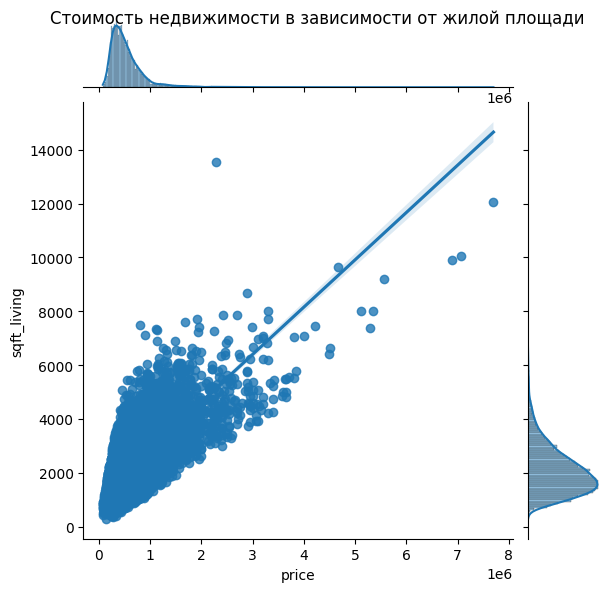

In [50]:
p = sns.jointplot(x=df['price'], y=df['sqft_living'], kind='reg')
p.fig.suptitle("Стоимость недвижимости в зависимости от жилой площади");

3.1. График показывает, что чем больше жилая площадь, тем выше цена недвижимости.  

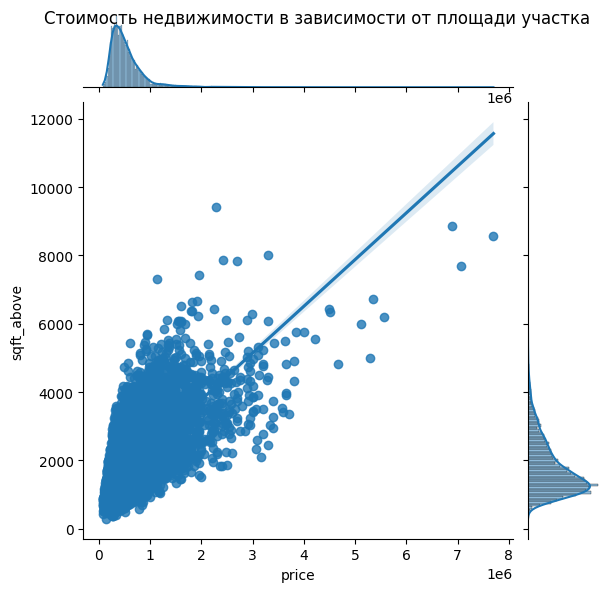

In [51]:
p = sns.jointplot(x=df['price'], y=df['sqft_above'], kind='reg')
p.fig.suptitle("Стоимость недвижимости в зависимости от площади участка");

3.2. График показывает, что чем больше площадь участка, тем выше цена недвижимости.  

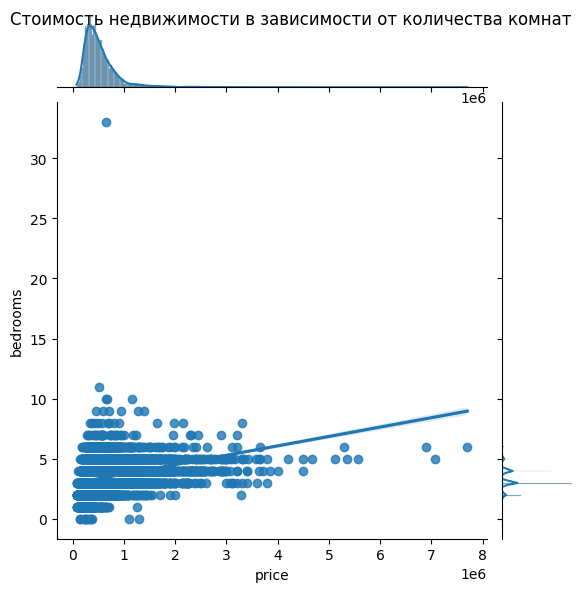

In [52]:
p = sns.jointplot(x=df['price'], y=df['bedrooms'], kind='reg')
p.fig.suptitle("Стоимость недвижимости в зависимости от количества комнат");

3.3. График показывает, что чем больше количества комнат, тем выше цена недвижимости.  

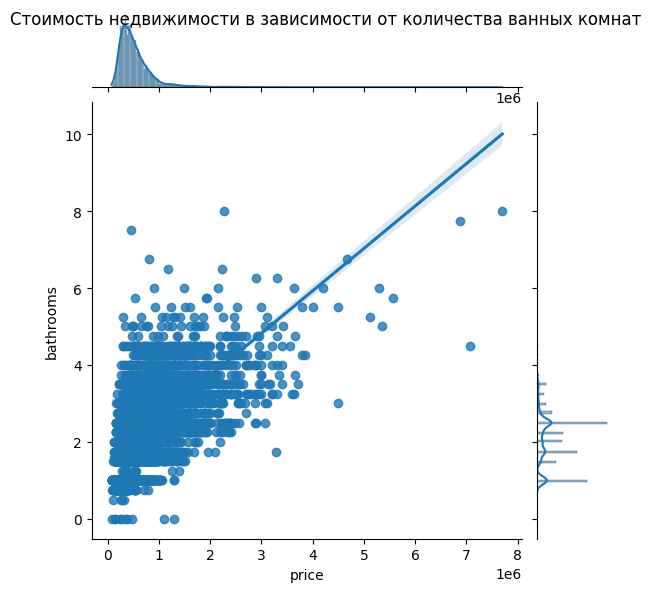

In [53]:

p = sns.jointplot(x=df['price'], y=df['bathrooms'], kind='reg')
p.fig.suptitle("Стоимость недвижимости в зависимости от количества ванных комнат");

3.4. График показывает, что чем больше количества ванных комнат, тем выше цена недвижимости.  

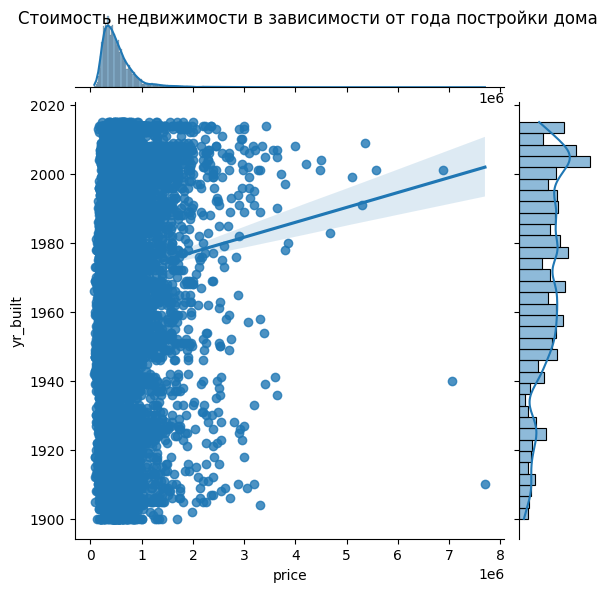

In [54]:

p = sns.jointplot(x=df['price'], y=df['yr_built'], kind='reg')
p.fig.suptitle("Стоимость недвижимости в зависимости от года постройки дома");

3.5. График показывает, что чем выше год постройки недвижимости, тем она ниже в цене.  

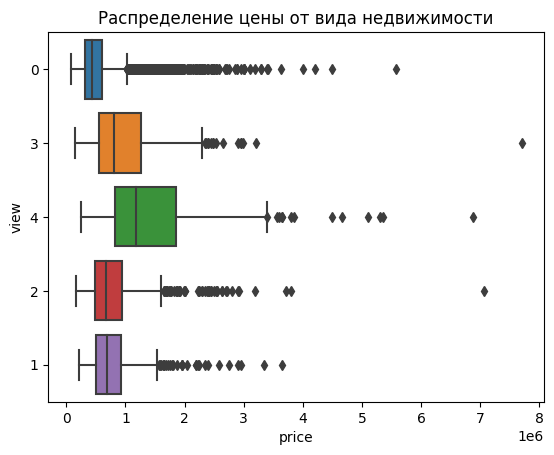

In [62]:
sns.boxplot(x=df['price'], y=df['view'].astype('str'), whis=1.5)
plt.xlabel('price')
plt.ylabel('view')
plt.title('Распределение цены от вида недвижимости');

3.6. График показывает, что если исключить выбросы, то максимальная стоимость недвижимости 4-х комнатных домов.  

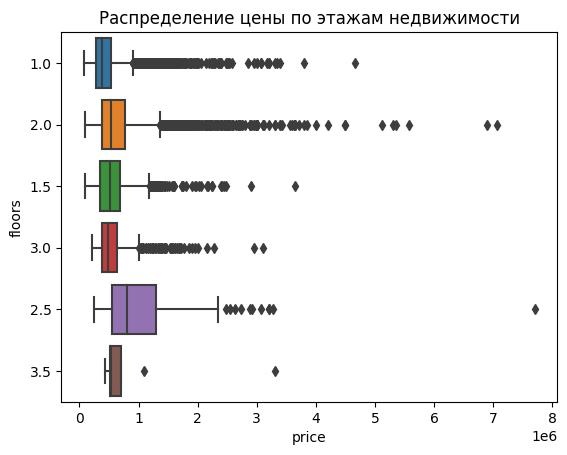

In [63]:
sns.boxplot(x=df['price'], y=df['floors'].astype('str'), whis=1.5)
plt.xlabel('price')
plt.ylabel('floors')
plt.title('Распределение цены по этажам недвижимости');

3.7. График показывает, что если исключить выбросы, то максимальная стоимость недвижимости 2.5 этажные дома.  

In [74]:
corr_matrix = df.corr(numeric_only=True)
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
price,0.0,1.0,0.3,0.5,0.7,0.0,0.3,0.3,0.4,0.0,0.7,0.6,0.3,0.0,0.0,0.0,0.3,0.0,0.6,0.0
bedrooms,0.0,0.3,1.0,0.5,0.6,0.0,0.0,0.0,0.0,0.0,0.4,0.5,0.3,0.0,0.0,0.0,0.0,0.0,0.4,0.0
bathrooms,0.0,0.5,0.5,1.0,0.8,0.0,0.5,0.0,0.0,0.0,0.7,0.7,0.3,0.5,0.0,0.0,0.0,0.0,0.6,0.0
sqft_living,0.0,0.7,0.6,0.8,1.0,0.0,0.4,0.0,0.3,0.0,0.8,0.9,0.4,0.3,0.0,0.0,0.0,0.0,0.8,0.0
sqft_lot,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7
floors,0.0,0.3,0.0,0.5,0.4,0.0,1.0,0.0,0.0,-0.3,0.5,0.5,0.0,0.5,0.0,0.0,0.0,0.0,0.3,0.0
waterfront,0.0,0.3,0.0,0.0,0.0,0.0,0.0,1.0,0.4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
view,0.0,0.4,0.0,0.0,0.3,0.0,0.0,0.4,1.0,0.0,0.3,0.0,0.3,0.0,0.0,0.0,0.0,0.0,0.3,0.0
condition,0.0,0.0,0.0,0.0,0.0,0.0,-0.3,0.0,0.0,1.0,0.0,0.0,0.0,-0.4,0.0,0.0,0.0,0.0,0.0,0.0


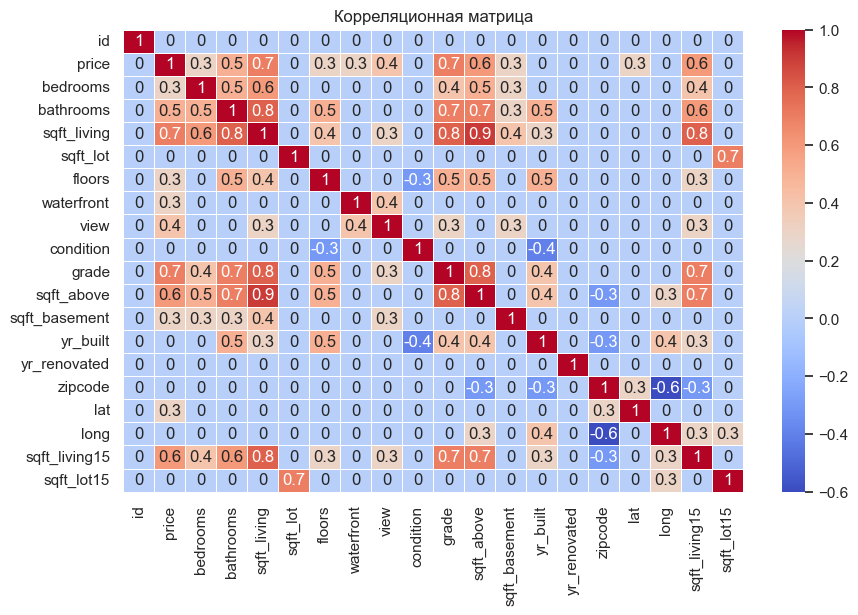

In [81]:
plt.figure(figsize=(10, 6))
sns.set(font_scale=1)
sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')
plt.title('Корреляционная матрица');

3.8. График показывает, что наиболее сильная линейная связь имеет от количества комнат и площади недвижимости, а так же сильная зависимость от качества конструкции и площади дома, находящиеся выше земли.

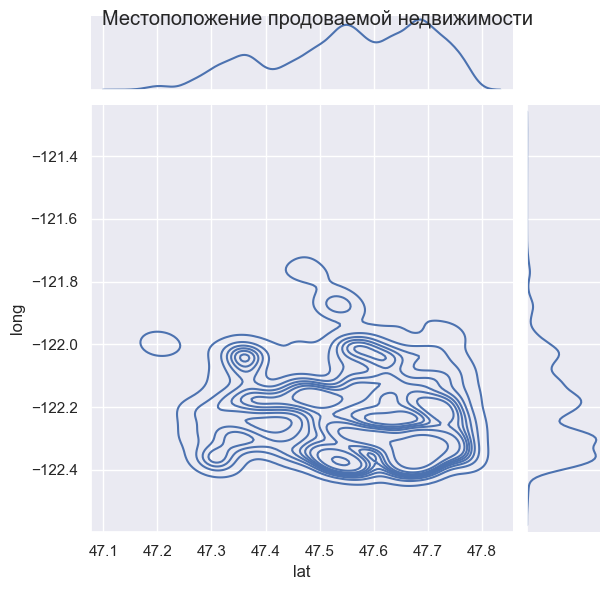

In [84]:
p = sns.jointplot(x=df['lat'], y=df['long'], kind='kde')
p.fig.suptitle("Местоположение продоваемой недвижимости");

3.9. График показывает, что есть некий район, который расположен по отдоль от остальной недвижимости.  

In [90]:
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.lat, point.long],
        radius=2,
        popup=point.price
    ).add_to(this_map)

df.apply(plotDot, axis=1)
this_map.fit_bounds(this_map.get_bounds())
this_map

3.10. График показывает, координаты продоваемой недвижимости на карте.  